### Dataset: original road safety dataset
### Data analysis:
* The number of accidents on different road class in each year.
* "1st_Road_Class" VS "2nd_Road_Class".
* Figure out the meaning of "2nd_Road_Class" column.
* Visualise accidents on map.


In [1]:
import matplotlib.pyplot as plt
import matplotlib
import pandas as pd
import numpy as np
import folium
matplotlib.style.use('ggplot')

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


## 2013 road accident data in GB


In [18]:
import pandas as pd
import numpy as np
df = range(6)
df[0] = pd.read_csv('data/DfTRoadSafety_Accidents_2009.csv',low_memory=False)
df[1] = pd.read_csv('data/DfTRoadSafety_Accidents_2010.csv',low_memory=False)
df[2] = pd.read_csv('data/DfTRoadSafety_Accidents_2011.csv',low_memory=False)
df[3] = pd.read_csv('data/DfTRoadSafety_Accidents_2012.csv',low_memory=False)
df[4] = pd.read_csv('data/DfTRoadSafety_Accidents_2013.csv',low_memory=False)
df[5] = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)

In [2]:
df[0].columns

Index([u'Accident_Index', u'Location_Easting_OSGR', u'Location_Northing_OSGR',
       u'Longitude', u'Latitude', u'Police_Force', u'Accident_Severity',
       u'Number_of_Vehicles', u'Number_of_Casualties', u'Date', u'Day_of_Week',
       u'Time', u'Local_Authority_(District)', u'Local_Authority_(Highway)',
       u'1st_Road_Class', u'1st_Road_Number', u'Road_Type', u'Speed_limit',
       u'Junction_Detail', u'Junction_Control', u'2nd_Road_Class',
       u'2nd_Road_Number', u'Pedestrian_Crossing-Human_Control',
       u'Pedestrian_Crossing-Physical_Facilities', u'Light_Conditions',
       u'Weather_Conditions', u'Road_Surface_Conditions',
       u'Special_Conditions_at_Site', u'Carriageway_Hazards',
       u'Urban_or_Rural_Area', u'Did_Police_Officer_Attend_Scene_of_Accident',
       u'LSOA_of_Accident_Location'],
      dtype='object')

In [2]:
df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
df.columns

Index([u'﻿Accident_Index', u'Location_Easting_OSGR', u'Location_Northing_OSGR',
       u'Longitude', u'Latitude', u'Police_Force', u'Accident_Severity',
       u'Number_of_Vehicles', u'Number_of_Casualties', u'Date', u'Day_of_Week',
       u'Time', u'Local_Authority_(District)', u'Local_Authority_(Highway)',
       u'1st_Road_Class', u'1st_Road_Number', u'Road_Type', u'Speed_limit',
       u'Junction_Detail', u'Junction_Control', u'2nd_Road_Class',
       u'2nd_Road_Number', u'Pedestrian_Crossing-Human_Control',
       u'Pedestrian_Crossing-Physical_Facilities', u'Light_Conditions',
       u'Weather_Conditions', u'Road_Surface_Conditions',
       u'Special_Conditions_at_Site', u'Carriageway_Hazards',
       u'Urban_or_Rural_Area', u'Did_Police_Officer_Attend_Scene_of_Accident',
       u'LSOA_of_Accident_Location'],
      dtype='object')

In [4]:
df = pd.read_csv('data/DfTRoadSafety_Accidents_2015.csv',low_memory=False)
df.columns

Index([u'﻿Accident_Index', u'Location_Easting_OSGR', u'Location_Northing_OSGR',
       u'Longitude', u'Latitude', u'Police_Force', u'Accident_Severity',
       u'Number_of_Vehicles', u'Number_of_Casualties', u'Date', u'Day_of_Week',
       u'Time', u'Local_Authority_(District)', u'Local_Authority_(Highway)',
       u'1st_Road_Class', u'1st_Road_Number', u'Road_Type', u'Speed_limit',
       u'Junction_Detail', u'Junction_Control', u'2nd_Road_Class',
       u'2nd_Road_Number', u'Pedestrian_Crossing-Human_Control',
       u'Pedestrian_Crossing-Physical_Facilities', u'Light_Conditions',
       u'Weather_Conditions', u'Road_Surface_Conditions',
       u'Special_Conditions_at_Site', u'Carriageway_Hazards',
       u'Urban_or_Rural_Area', u'Did_Police_Officer_Attend_Scene_of_Accident',
       u'LSOA_of_Accident_Location'],
      dtype='object')

2015 dataset has the same columns as previous years.

## Road class counting 2009-2014
Count the number of accidents occured on different classes of road.

Most accidents occured on A roads

In [47]:
rst = [0]*6
for i in range(6):
    rst[i] = df[i]['1st_Road_Class'].value_counts()

road_class = pd.Series(['Motorway', 'A(M)', 'A', 'B', 'C', 'Unclassified'], index=[1,2,3,4,5,6])
df_road_class = pd.DataFrame({'1st road class': road_class,
                              '2009': rst[0], 
                              '2010': rst[1], 
                              '2011': rst[2], 
                              '2012': rst[3], 
                              '2013': rst[4],
                              '2014': rst[5]},
                             index = [1,2,3,4,5,6])
df_road_class

,1st road class,2009,2010,2011,2012,2013,2014
1,Motorway,6172,6066,5379,5212,4983,5246
2,A(M),471,434,440,403,414,384
3,A,74149,70274,69889,67166,64423,67828
4,B,20933,19755,19513,18795,17830,18573
5,C,15371,13947,14037,13225,12020,12969
6,Unclassified,46458,43938,42216,40770,38990,41322


## Show location of accidents as mark on the map
Different colours stand for different classes of accident severity

black - fatal

red - serious

orange - slight

In [69]:
import folium
Long = df[0].Longitude
Lat = df[0].Latitude
severity = df[0].Accident_Severity
se_color = {1:'#000000', 2: '#FF0000', 3:'#FF8400'}  #fatal: black; serious: red; slight: orange
map_osm = folium.Map(location=[Lat.values[0],Long.values[0]],zoom_start=12) # latitude and longitude
i=0
while (i<200):
    folium.CircleMarker([Lat.values[i],Long.values[i]],
                        radius = 100,
                        popup = 'Laurelhurst Park',
                        color = se_color[severity.values[i]],
                        fill_color = se_color[severity.values[i]],
                       ).add_to(map_osm)
    i+=1
map_osm.create_map(path='osm.html')
map_osm

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:16: FutureWarning: Map.create_map is deprecated. Use Map.save instead


## Accident severity statistics
The number of accidents with different severity level

In [9]:
rst = [0]*6
for i in range(6):
    rst[i] = df[i]['Accident_Severity'].value_counts()

severity = pd.Series(['fatal', 'serious', 'slight'], index=[1,2,3])
df_severity = pd.DataFrame({'accident severity': severity,
                              '2009': rst[0], 
                              '2010': rst[1], 
                              '2011': rst[2], 
                              '2012': rst[3], 
                              '2013': rst[4],
                              '2014': rst[5]},
                             index = [1,2,3])
df_severity = df_severity[['accident severity', '2009', '2010', '2011', '2012', '2013', '2014']]
df_severity

,accident severity,2009,2010,2011,2012,2013,2014
1,fatal,2057,1731,1797,1637,1608,1658
2,serious,21997,20440,20986,20901,19624,20676
3,slight,139500,132243,128691,123033,117428,123988


## Speed limit

In [19]:
rst = [0]*6
for i in range(6):
    rst[i] = df[i]['Speed_limit'].value_counts()

df_severity = pd.DataFrame({
                              '2009': rst[0], 
                              '2010': rst[1], 
                              '2011': rst[2], 
                              '2012': rst[3], 
                              '2013': rst[4],
                              '2014': rst[5]})
                             #index = [1,2,3])
df_severity

,2009,2010,2011,2012,2013,2014
10,2,2,NaN,1.0,NaN,NaN
15,2,1,NaN,NaN,NaN,NaN
20,1508,1548,1935.0,2247.0,2664.0,3418.0
30,105397,100261,99193.0,94995.0,89479.0,94997.0
40,13548,12591,12428.0,11914.0,11490.0,12017.0
50,5324,5193,5295.0,5220.0,5340.0,5797.0
60,26093,23510,22275.0,21172.0,19990.0,20016.0
70,11680,11308,10348.0,10022.0,9697.0,10077.0


In [26]:
rst[0] = df[0][['Speed_limit', 'Accident_Severity']]
rst[0]['Accident_Severity'].value_counts()

3    139500
2     21997
1      2057
Name: Accident_Severity, dtype: int64

## Weather Condition
Most accidents occured on fine days. Bad weather impacts the traffic, while people tend to avoid going out in bad weather. So the exposure reduced.

In [38]:
rst = [0]*6
for i in range(6):
    rst[i] = df[i]['Weather_Conditions'].value_counts()

weather = pd.Series(['Fine no high winds', 'Raining no high winds', 'Snowing no high winds',
                    'Fine + high winds', 'Raining + high winds', 'Snowing + high winds',
                    'Fog or mist', 'Other', 'Unknown', 'Data missing or out of range'], 
                    index=[1,2,3,4,5,6,7,8,9,-1])

df_severity = pd.DataFrame({'Weather Conditions': weather,
                              '2009': rst[0], 
                              '2010': rst[1], 
                              '2011': rst[2], 
                              '2012': rst[3], 
                              '2013': rst[4],
                              '2014': rst[5]},
                             index = [1,2,3,4,5,6,7,8,9,-1])
df_severity = df_severity[['Weather Conditions', '2009', '2010', '2011', '2012', '2013', '2014']]
df_severity

,Weather Conditions,2009,2010,2011,2012,2013,2014
1,Fine no high winds,128526,123396,124780.0,114743.0,112284.0,118879.0
2,Raining no high winds,19682,16485,15813.0,20116.0,14562.0,17665.0
3,Snowing no high winds,1916,3281,412.0,584.0,1737.0,227.0
4,Fine + high winds,2097,1202,2500.0,1289.0,1891.0,1575.0
5,Raining + high winds,2386,1314,1952.0,2178.0,2156.0,2333.0
6,Snowing + high winds,254,346,80.0,106.0,522.0,78.0
7,Fog or mist,788,956,655.0,905.0,619.0,753.0
8,Other,4502,4650,2660.0,2939.0,2412.0,2332.0
9,Unknown,3352,2729,2622.0,2711.0,2477.0,2480.0
-1,Data missing or out of range,51,55,NaN,NaN,NaN,NaN


## 1st road class VS 2nd road class

Explore the relationship between these two columns. Take 2013 data as example.
1. Extract these related columns: 1st road class, 1st road number, road type, speed limit, 2nd road class, 2nd road number.
2. visualised in Parallel Coordinates

In [1]:
import pandas as pd
from pandas.tools.plotting import parallel_coordinates
import matplotlib.pyplot as plt

df_13 = pd.read_csv('data/DfTRoadSafety_Accidents_2013.csv',low_memory=False)

road_class = df_13[['1st_Road_Class','Road_Type','Speed_limit','2nd_Road_Class',]]

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


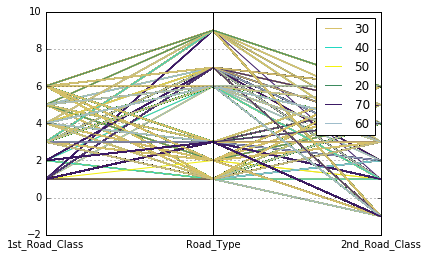

In [3]:
%matplotlib inline
plt.figure()
parallel_coordinates(road_class,'Speed_limit')
plt.show()

According to above graph. There is not specific relation between road type and road class. One kind of road class can be all 6 kinds of road type.

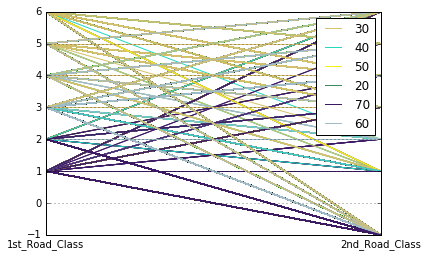

In [4]:
%matplotlib inline
plt.figure()
road_class2 = df_13[['1st_Road_Class','Speed_limit','2nd_Road_Class']]
parallel_coordinates(road_class2,'Speed_limit')
plt.show()

####  1 - Motorway;    2 - A(M);   3 - A;   4 - B;    5 - C;   6 -Unclassified;  -1 - data missing

From above graph, it can be seen that there is no aparent relation or correspondence between 1 road class and 2nd road class.

Here, different colours stand for different road speed limit. It is clear that higher speed limit concentrates in 1 (Motorway) 1st road class, but scattered in all 2nd road classes. So it makes more sense that we use the column of 1_road_class as road classification in future research. Due to the high percentage of missing data in 2nd_Road_Class, I will abandon this dataset.

(*The official explanation of the relation between 1_Road_Class and 2nd_Road_Class was not found. It may refer to the nearest joint road*)

## More 2nd_Road_Class
2nd_road_class is related to road junction.

Take data from year 2014 as example

If the accident was not at junction or within 20 metres (coded as 0 in *Jucntion_Detail*), there would not be meaningful data in *Junction_Control, 2nd_Road_Class, 2nd_Road_Number*.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x117257e10>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x11d74ce90>]], dtype=object)

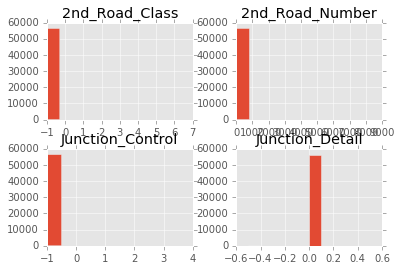

In [14]:
%matplotlib inline
df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
df = df[['Junction_Detail','Junction_Control', '2nd_Road_Class','2nd_Road_Number']]
df = df[df['Junction_Detail']== 0]
df.hist()

#### Histogram of accidents in 2014

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x11ad872d0>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x11bee5450>]], dtype=object)

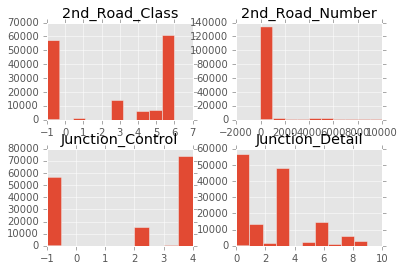

In [15]:
%matplotlib inline
df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
df = df[['Junction_Detail','Junction_Control', '2nd_Road_Class','2nd_Road_Number']]
df.hist()

#### Junction_Detail
    0 - Not at junction or within 20 metres
    1 - Roundabout
    2 - Mini-roundabout
    3 - T or staggered junction
    5 - Slip road
    6 - Crossroads
    7 - More than 4 arms (not roundabout)
    8 - Private drive or entrance
    9 - Other junction
    -1 - Data missing or out of range

#### Junction_Control
    0 - Not at junction or within 20 metres
    1 - Authorised person
    2 - Auto traffic signal
    3 - Stop sign
    4 - Give way or uncontrolled
    -1 - Data missing or out of range

* Most 2nd_Road_Number records are just 0. So this column has very little useful information, should be removed.
* 38.6% accidents did not occured at a junction. While 32.8% accidents occured at a T or staggered junction.
* 2nd_Road_Class: A large mount of data is missing or out of range(-1), because the accidents did not occured at a junction. A part from that, most roads are unclassified. Therefore, it will be no use to keep data in this column.
* Junction_Control: Similar to 2nd_Road_Class, a part from unavailable missing data, most accidents occured at a giveway or uncontrolled junction.

#### Conclusion:
* Drop 2nd_Road_Class and 2nd_Road_Number columns.
* Pend Junction_Detail and Junction_Control 

#### Situation in other years
    Similar to that of 2014

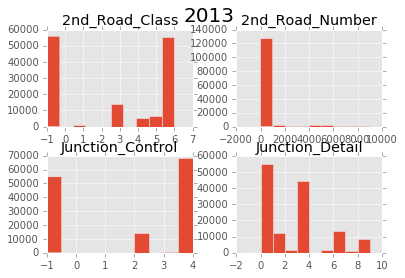

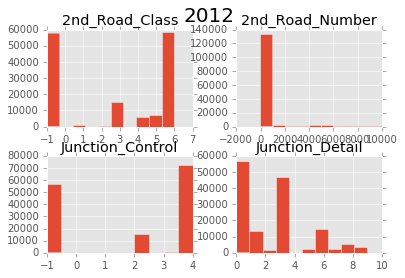

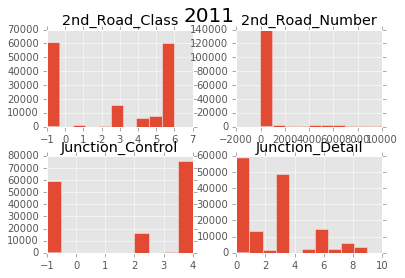

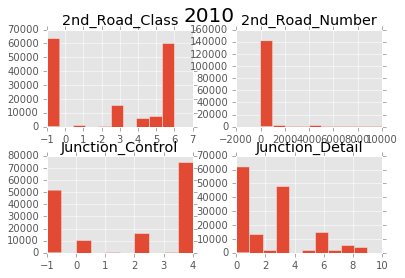

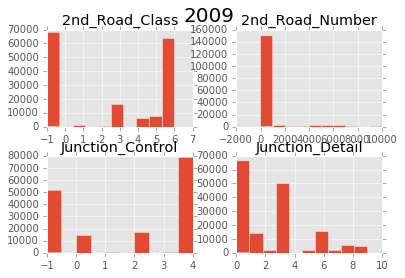

In [29]:
%matplotlib inline
years = ['2013','2012', '2011', '2010', '2009']
for year in years:
    df = pd.read_csv('data/DfTRoadSafety_Accidents_' + year + '.csv',low_memory=False)
    df = df[['Junction_Detail','Junction_Control', '2nd_Road_Class','2nd_Road_Number']]
    df.hist()
    plt.suptitle(year, fontsize = 20)

# Motorways and A roads

Highways England manages Motorways and major A roads in England. The dataset covers accidents reported to police all over the Great British. To suit the case of Highways England better, I will only focus on accidents from Motorways and A roads. 


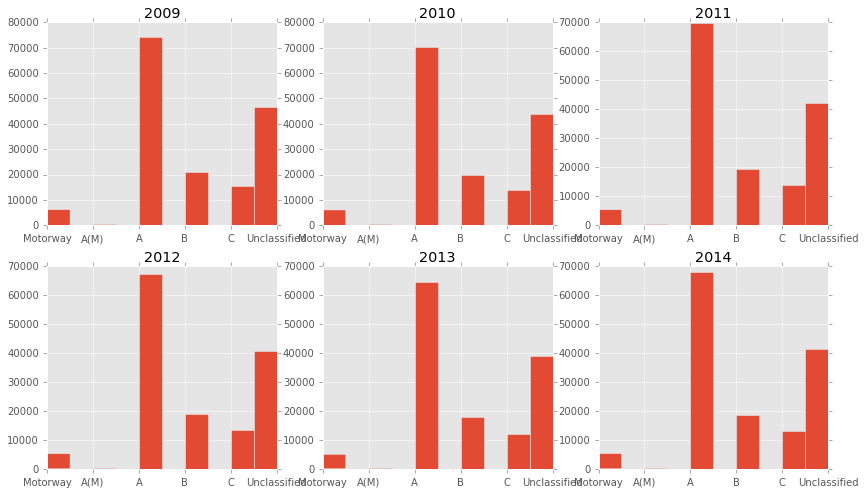

In [45]:
%matplotlib inline
years = ['2009', '2010', '2011', '2012', '2013', '2014']
plt.figure(figsize=(14,8))
i = 1
for year in years:
    plt.subplot(2,3,i)
    df = pd.read_csv('data/DfTRoadSafety_Accidents_' + year + '.csv',low_memory=False)
    df['1st_Road_Class'].hist()
    plt.xticks([1,2,3,4,5,6],['Motorway', 'A(M)','A','B','C','Unclassified'])
    plt.title(year)
    i+=1

Droping data from B, C, and unclassified roads means droping over a half data.

#### All accidents on Motorway in 2014

In [3]:
import folium

df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
rst = df[df['1st_Road_Class'] == 1]
Long = rst.Longitude
Lat = rst.Latitude
severity = rst.Accident_Severity
se_color = {1:'#000000', 2: '#FF0000', 3:'#FF8400'}  #fatal: black; serious: red; slight: orange
map_osm = folium.Map(location=[Lat.values[0],Long.values[0]]) #,zoom_start=12) # latitude and longitude
i=0
while (i<len(Long)):
    folium.CircleMarker([Lat.values[i],Long.values[i]],
                        radius = 10,
                        popup = 'Laurelhurst Park',
                        color = se_color[severity.values[i]],
                        fill_color = se_color[severity.values[i]],
                       ).add_to(map_osm)
    i+=1
map_osm.create_map(path='osm.html')
map_osm

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:19: FutureWarning: Map.create_map is deprecated. Use Map.save instead


### Fatal and serious accidents on Motorway and A(M) roads in 2014

In [6]:
import folium

df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
rst = df[(df['1st_Road_Class'] <= 2) & (df['Accident_Severity'] < 3)]
Long = rst.Longitude
Lat = rst.Latitude
severity = rst.Accident_Severity
se_color = {1:'#000000', 2: '#FF0000', 3:'#FF8400'}  #fatal: black; serious: red; slight: orange
map_osm = folium.Map(location=[Lat.values[0],Long.values[0]]) #,zoom_start=12) # latitude and longitude
i=0
while (i<len(Long)):
    folium.CircleMarker([Lat.values[i],Long.values[i]],
                        radius = 10,
                        popup = 'Laurelhurst Park',
                        color = se_color[severity.values[i]],
                        fill_color = se_color[severity.values[i]],
                       ).add_to(map_osm)
    i+=1
map_osm.create_map(path='osm.html')
map_osm

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:19: FutureWarning: Map.create_map is deprecated. Use Map.save instead


#### All accidents on Motorway and A(M) roads in 2014
(Mainly on Motorway)

In [4]:
import folium

df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
rst = df[df['1st_Road_Class'] <= 2]
Long = rst.Longitude
Lat = rst.Latitude
severity = rst.Accident_Severity
se_color = {1:'#000000', 2: '#FF0000', 3:'#FF8400'}  #fatal: black; serious: red; slight: orange
map_osm = folium.Map(location=[Lat.values[0],Long.values[0]]) #,zoom_start=12) # latitude and longitude
i=0
while (i<len(Long)):
    folium.CircleMarker([Lat.values[i],Long.values[i]],
                        radius = 10,
                        popup = 'Laurelhurst Park',
                        color = se_color[severity.values[i]],
                        fill_color = se_color[severity.values[i]],
                       ).add_to(map_osm)
    i+=1
map_osm.create_map(path='osm.html')
map_osm

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:19: FutureWarning: Map.create_map is deprecated. Use Map.save instead


### Fatal and serious accidents on Motorway, A(M) and A roads

In [5]:
import folium

df = pd.read_csv('data/DfTRoadSafety_Accidents_2014.csv',low_memory=False)
rst = df[(df['1st_Road_Class'] <= 3) & (df['Accident_Severity'] < 3)]
Long = rst.Longitude
Lat = rst.Latitude
severity = rst.Accident_Severity
se_color = {1:'#000000', 2: '#FF0000', 3:'#FF8400'}  #fatal: black; serious: red; slight: orange
map_osm = folium.Map(location=[Lat.values[0],Long.values[0]]) #,zoom_start=12) # latitude and longitude
i=0
while (i<len(Long)):
    folium.CircleMarker([Lat.values[i],Long.values[i]],
                        radius = 10,
                        popup = 'Laurelhurst Park',
                        color = se_color[severity.values[i]],
                        fill_color = se_color[severity.values[i]],
                       ).add_to(map_osm)
    i+=1
map_osm.create_map(path='osm.html')
map_osm

/Users/XueqiWang/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:19: FutureWarning: Map.create_map is deprecated. Use Map.save instead
